# Sugar Scape Case Study: Sweet Suprises about Society
Writen and Coded by: Gerardo Cisneros Mendoza(Student No. 21993026) & Rhys Collier(Student No. 22222918)

## Chapter 0 - In the beginning...
Resource allocation, life, death, sex, conflict, culture, evolution, trade, and disease are all components of human societies. These components have helped to drive own lives, the lives of those around us, and every person that has ever lived throughout history of. But these components are also an important part of another type of society and environment that exists within its own universe and even has its own history. 

This universe and world is the sugarscape, an agent-based computational model that creates miniature societies to help us to understand our own societies.

The sugarscape, like our own society, has a long history, be it a shorter history, which started nearly 50 years ago. In 1969 Thomas C. Schelling, an economist from the University of Maryland, released the paper "Models of Segregation"[1]. This paper laid down the basis for agent-based modelling, but due to the limited computer power at the time the model was simplistic and small. As time passed and computer become more powerful, there was a greater quantity that could be achieved by computational models. This was especially true with "life like" simulation and the graphical representation of these. One of the most famous of these early pioneering models is the appropriately named "Game of Life".

In 1996 Joshua M. Epstein and Robert Axtell released their book "Growing Artificial Societies: Social Science from the bottom up"[2]. It was this book that outlined the basics for what the world has come to know as the sugarscape of today. This case study will highlight and expanding upon some of the experiments covered in that book and look at some other interesting areas.

All the topics and experiments covered in this Case Study will be written in python code and will be explained. However, it has been assumed that the reader of this document will have a basic understanding of python and its commands. With this in mind explanation will not be provided on the more basic level parts of the code. Before any complicated procedures and code can be started there is a requirement to lay out the basics components of what a sugarscape is and how it operates.

### Components of this New World
 In simplicity a sugarscape consists of 3 overall components, which are:
>___Environment:___ A 2-dimensional lattice, or grid, that can hold values in discreet regions. In its simplicity the lattice can hold a set of values that represent resources, but it can also represents a wide variant of information. It is a medium that allows "Agents" to act within.

>___Agents:___ The agents are the subjects of this simulation and can be considered the "people" of this "Enviroment". They are often governed by fixed and dynamic rules that effect what decisions are made over the progress of the simulation. 

>___Rules:___ Rules represent the decision trees that agents take to perform actions in the "Enviroment". There are 3 types of rules:
    
    >>Agent-Environment rules where due to the environment the agent does an action e.g. if grid x sugar > grid y sugar then agent a move to grid x. 
    
    >>Environment-Environment rules where the environment effects itself e.g. if grid y sugar is a then grid x sugar equal increases by 1/10th of grid y's sugar. 
    
    >>Agent-Agent rules are where agents interact with each other e.g. combat, mating, trading or such actions.

As the simulation runs the agents will proceed and act out the rules within the environment until the simulation is terminated, or all the agents "die". Without these 3 components the sugarscape could not function. However, as you might have noticed, those descriptions are rather broad and not specific. No set rules are laid out and this is the point. It provides the flexibility for a variety of different phenomena to be studied in a relatively similar environment, and to quote Epstein and Axtell, "function as a kind of laboratory, a compuTerrarium"[2].

With these definitions established it is now possible to start the coding and specific definitions for  Case Study.

### In The Beginning... There Was Sugar
The start of our python code will be to import several libraries and functions into our workspace. The functions within these libraries will allow us to save time by not having to rewrite existing functions, and to increase the efficiency of the code by using more well written and tested algorithms. It must be noted that libraries include everything that is need for the entire case study. Here are all the libraries and their determined use:
> ___numpy:___ numpy is at it's core a package for scientific computation and contains many functions in a variety of areas. However, this document's code will primarily use the library for it's "array objects", which are more efficient  computationally then their python equivalent, "lists". 

>___matplotlib:___ Is a 2D plotting library. It contains a variety of different plotting functions. For this document, the library will be used for its colours and "rc" parameters. 

>___warnings:___ A default python package to show and process warnings for display. Useful if anything goes wrong.

The remaining three imports are from files written by Allen B. Downey for his book "Think Complexity Version 2", and a copy of each of these files can be found on his github page https://github.com/AllenDowney/ThinkComplexity2.  

>___Cell2D:___ 

>___thinkplot:___

>___thinkstats2:___ 

The code set below will import all these mentioned libaries.

In [51]:
from __future__ import print_function, division

%matplotlib inline

import numpy as np

import matplotlib.pyplot as plt
from   matplotlib import rc
from   matplotlib.colors import LinearSegmentedColormap
rc('animation', html='html5')


import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)

from Cell2D import Cell2D, Cell2DViewer
from scipy.signal import correlate2d

import thinkplot
from thinkstats2 import Cdf
from thinkstats2 import RandomSeed

plt.rcParams['animation.ffmpeg_path'] = 'C:\\ffmpeg\\bin\\ffmpeg.exe'

Now that the appropriate libraries and functions have been imported, the coding of the environment can be conducted and will allow for a more definite definition of what sugar and the environment really is.

Our environment will be represented on a 2-dimensional lattice or grid with discrete integer values for every point, or discrete whole numbers. These integer values represent the "sugar", a resource that agents must eat to survive or use to perform other actions. In some ways it represents the energy of our world, be it oil, food or the sun. Due to this, it is usually sought after by agents in their programming.

To store our environment the code will not be utilising a typical python list, dynamic array, but instead will use a numpy array. As it improves performance by reducing the operation counts performed during run time, and gives access to several functions not available to python lists. The reason for this is complicated and will not be discussed further here.

With the basic foundational storage unit put down for the environment there are a variety of different rules for the regrowth of sugar in the system that could be used. Here are a few examples:

    - Sugar grows up instantly to its capacity.
    - Sugar grows up at a rate of unit per time step.
    - Sugar grows up at different rates in different regions of the sugarscape.
    - Sugar grows up based on the sugar level of its neighbouring sites.

For the first few experiments a fixed growth rate of sugar per unit time will e used, up to some maximum value determined at the start of the simulation represented by a second static numpy array. This will allows for a much more controlled, but varied input rate of sugar into the environment. With this information established the foundations for the environment can be laid with the following code.

In [52]:
# The following temporary classes will use to help break up the code 
#   into easily viewable chunks as the explination is provided. The 
#   entire thing will be redefined again in sugarscape class later
#   on in the document.

# Our enviroment class that will retain all the enviroment variables
#   and rules.
class SugarscapeTemp(Cell2D):
    """Represents an Epstein-Axtell Sugarscape."""
    
    def __init__(self, n, **params):
        """Initializes the attributes.

        n: number of rows and columns
        params: dictionary of parameters
        """
        self.n = n
        self.params = params
        
        # track variables
        self.grow_rate = params.get('growth_rate', 4)
        self.sugarpeaks = params.get('sugarpeaks', [[15,15],[35,35]])
        self.capacity,self.higher_capacity_locations  = self.make_capacity()
        #self.higher_capacity_locations
        
        # initially all cells are at capacity
        self.array = self.capacity.copy()
         
    def make_capacity(self):
        """Makes the capacity array. This is done primarily by calculating the
           minimum distance between any of the peaks and the point in the
           array. This distance is then assigned a value depending on this
           minimum value."""
        
        # compute the distance of each cell from the peaks. 
        x = np.arange(self.n) # most numpy, np, operators create a numpy  array
        rows, cols = np.meshgrid(x, x, indexing='ij')
        
        # each cell in `rows` contains its own `i` coordinate
        # each cell in `cols` contains its `j` coordinate
        # creates the sugar peaks at this positions
        distHypots = []
        dist = np.hypot(rows-self.sugarpeaks[0][0], cols-self.sugarpeaks[0][1])
        for sugarpeakPos in self.sugarpeaks:
            distHypots.append(np.hypot(rows-sugarpeakPos[0], cols-sugarpeakPos[1]))
        
        for distHypot in distHypots:
            dist = np.minimum(dist, distHypot)
        
        # cells in the capacity array are set according to dist from peak
        a = np.zeros((self.n, self.n), np.float)
        a[dist>=16] = 1
        a[dist<16] = 2
        a[dist<11] = 3
        a[dist<6] = 4
        higher_capacity_counter = len(a[dist<6] == 4)
        
        return a, higher_capacity_counter 
    
    def grow(self):
        """Adds sugar to all cells and caps them by capacity."""
        grow_rate = self.params.get('grow_rate', self.grow_rate)
        self.array = np.minimum(self.array + grow_rate, self.capacity)
        
# This class will allow us to display our enviroment for easy viewing.
class SugarscapeViewerTemp(Cell2DViewer):
    """Generates visualization and animation of Sugarscape."""
    
    cmap = plt.get_cmap('YlOrRd')
    
    options = dict(interpolation='none', alpha=0.8,
                   vmin=0, vmax=9)
    
    def draw(self, grid=False):
        """Draws the array and any other elements.
        
        grid: boolean, whether to draw grid lines
        """
        self.draw_array(self.viewee.array, origin='lower')

A quick visualisation of the enviroment can be made by plotting it. It must be noted that the functions and classes used here will be explained in detail later on in the document. 

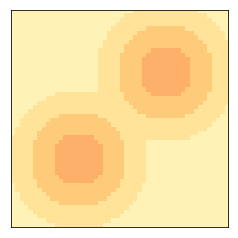

In [53]:
# if the following block of code providing the error
#   "name 'Sugarscape' is not defined" then simply
#   use "run all" function under "Cell" tab and 
#   try again. 
envA = SugarscapeTemp(50)
viewerA = SugarscapeViewerTemp(envA)
viewerA.draw()

___Figure 1:___ Default environment configuration

This is the default configuration for our environment. In the code above, it is possible to define the layout for the world. This is achieved by using the sugar peaks parameter that takes in a standard python list and outputs different world with the array values corresponding with sugar peaks. Figure 2 shows a number of different configurations that includes 1 to 5 peaks and a horizontal and vertical line enviroment:

In [54]:
sugarpeaksA    = [ [25,25] ]  # One main central sugar peak
sugarpeaksB    = [ [15,15], [35,35] ] # Standard sugar peaks as book replicates it
sugarpeaksC    = [ [10,13], [24,36], [37,12] ] # 3 sugar peaks
sugarpeaksD    = [ [10,10], [40,10], [10,40], [40,40] ] # 4 sugar peaks
sugarpeaksE = [ [10,10], [40,10], [25,25], [10,40], [40,40] ] # 5 sugar peaks

sugarpeaksHorz = []
sugarpeaksVert = []

for i in range(0, 50):
    sugarpeaksHorz.append([25,i])
    sugarpeaksVert.append([i,25])

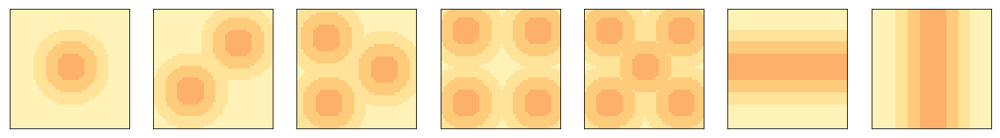

In [55]:
sugarpeaksA    = [ [25,25] ]  # One main central sugar peak
sugarpeaksB    = [ [15,15], [35,35] ] # Standard sugar peaks as book replicates it
sugarpeaksC    = [ [10,13], [24,36], [37,12] ] # 3 sugar peaks
sugarpeaksD    = [ [10,10], [40,10], [10,40], [40,40] ] # 4 sugar peaks
sugarpeaksE = [ [10,10], [40,10], [25,25], [10,40], [40,40] ] # 5 sugar peaks

sugarpeaksHorz = []
sugarpeaksVert = []

for i in range(0, 50):
    sugarpeaksHorz.append([25,i])
    sugarpeaksVert.append([i,25])

envA    = SugarscapeTemp(50, sugarpeaks=sugarpeaksA)
envB    = SugarscapeTemp(50, sugarpeaks=sugarpeaksB)
envC    = SugarscapeTemp(50, sugarpeaks=sugarpeaksC)
envD    = SugarscapeTemp(50, sugarpeaks=sugarpeaksD)
envE    = SugarscapeTemp(50, sugarpeaks=sugarpeaksE)
envHorz = SugarscapeTemp(50, sugarpeaks=sugarpeaksHorz)
envVert = SugarscapeTemp(50, sugarpeaks=sugarpeaksVert) 

fig = plt.figure(figsize = (20,20))

ax1 = fig.add_subplot(1,7,1)
viewerA  =  SugarscapeViewerTemp(envA)
viewerA.draw()

ax2 = fig.add_subplot(1,7,2)
viewerB  =  SugarscapeViewerTemp(envB)
viewerB.draw()

ax3 = fig.add_subplot(1,7,3)
viewerC  =  SugarscapeViewerTemp(envC)
viewerC.draw()

ax4 = fig.add_subplot(1,7,4)
viewerD  =  SugarscapeViewerTemp(envD)
viewerD.draw()

ax5 = fig.add_subplot(1,7,5)
viewerE  =  SugarscapeViewerTemp(envE)
viewerE.draw()

ax6 = fig.add_subplot(1,7,6)
viewerHorz  =  SugarscapeViewerTemp(envHorz)
viewerHorz.draw()

ax7 = fig.add_subplot(1,7,7)
viewerVert  =  SugarscapeViewerTemp(envVert)
viewerVert.draw()

___Figure 2:___ A variety of different enviroments from different intital starting conditions

With this foundation set for the environment and sugar, the coding of agents can be conducted.

### Then there was life
Agents are the creatures of the sugarscape world. This section of the document will look at defining these agents and the basic agent-environment rules for the experiments.

The first major rule is that all agents exist within the environment and occupy a cell within the environmental lattice. It is not possible for other agents to occupy a cell already occupied by another agent. However, it is possible for an agent to jump over any number of cells if it can do so. With that in mind, agents are also able to move throughout the environment, but they can only move north, south, east and west, not diagonally. They can move any number of squares they wish. These rules were decided upon for simplicity rather than any other reason. It is entirely possible to conduct a sugarscape that allows for agents to travel in any direction and be limited by a certain movement range.

Secondly, to give the agents some purpose in their movements with the environment, the agents will be able to "see" or "sense" the sugar around them. All agents will have a sight attribute that will be used to determine how far they can "see" in any of the 4 movable directions, north, south, east, and west. "Seeing" involves returning the value of the "sugar" present at those points in the environment. Figure 3 helps to visualise this. The blue regions represent the points viewable by the agent.

<img src="vision_location_grid.png">
___Figure 3:___ What an agent would be able to see with a viewable distance of 2 at position 0,0

This can easily replicated through the following code, which outputs an array of all viewable points and is organised from closest to furthest away.

In [56]:
def make_visible_locs(vision):
    """Computes the kernel of visible cells. The cells are
    at sorted in increasing distances from the centre. The
    cells at each distance are shuffled.
        
    vision: int distance
    """
    def make_array(d):
        """Generates visible cells with increasing distance."""
        a = np.array([[-d, 0], [d, 0], [0, -d], [0, d]])
        np.random.shuffle(a)
        return a
                     
    arrays = [make_array(d) for d in range(1, vision+1)]
    return np.vstack(arrays)

make_visible_locs(2)

array([[ 0,  1],
       [ 0, -1],
       [-1,  0],
       [ 1,  0],
       [ 0, -2],
       [ 0,  2],
       [-2,  0],
       [ 2,  0]])

In addition, the world itself will be treated like a torus, as demonstrated in figure 10. In other world the world raps around on itself like the old style 2d arcade games, like Asteroid and Pac-Man. Agents will be able to move from one side of the environment to the corresponding side on the other edge.

<img src="Torus_from_rectangle.gif">
___Figure 4:___ Flat plane being turned into a torus.[reference wikipedia]

With this in place an agent will be able to move to any point it wants within its sight range. To begin with it will be the point with the greatest quantity of sugar. Once it has arrived there, the agent will collect the sugar on the tile and add it to some internal value, representing stored sugar. Finally, the only agent-agent rule, currently, will be that each agent will have an internal value called metabolism, which will determine how much sugar will be consumed from the agents internal stored total at each time step.

Now that the rules have established the agents will be required to store the following current values:
    - Stored Sugar: Total amount of sugar collected and not consumed by the agent
    - Position: Where the agent is within the environment
    - Sight value: How far the agent can see
    - Metabolism: How much sugar is consumed each time step.
    
With that it is now possible to provide the code for the agents, under the _Agent_ class. 

In [57]:
# The following temporary classes will use to help break up the code 
#   into easily viewable chunks as the explination is provided. The 
#   entire thing will be redefined again in sugarscape class later
#   on in the document.

class AgentTemp:
    
    def __init__(self, loc, params):
        """Creates a new agent at the given location.
        
        loc: tuple coordinates
        params: dictionary of parameters
        """
        self.loc = tuple(loc)

        # extract the parameters
        max_vision = params.get('max_vision', 6)
        max_metabolism = params.get('max_metabolism', 4)
        min_sugar = params.get('min_sugar', 5)
        max_sugar = params.get('max_sugar', 25)
        
        # choose attributes
        self.vision = np.random.randint(1, max_vision+1)
        self.metabolism = np.random.uniform(1, max_metabolism)
        self.sugar = np.random.uniform(min_sugar, max_sugar)
        self.color = self.agent_color()

    def step(self, env):
        """Look around, move, and harvest.
        
        env: Sugarscape
        """
        self.loc = env.look_around(self.loc, self.vision)
        self.sugar += env.harvest(self.loc) - self.metabolism


    def agent_color(self):
        if self.metabolism <= 2: 
            return 'green'
        elif self.metabolism <= 3:
            return 'blue'
        elif self.metabolism <= 4:
            return 'red' 
        else: 
            return'yellow'

As is apparent, there are several calls to some environment functions not actually present in the original code. These functions will implement the agents ability to moving and collecting sugar. Some other functions have been added to store the agents within the environment class as well as functions to add agents to the world.

In [58]:
# The following temporary classes will use to help break up the code 
#   into easily viewable chunks as the explination is provided. The 
#   entire thing will be redefined again in sugarscape class later
#   on in the document.

# Function used for generating list of locations to place agents at 
#   the begining of the simulation.
# The following temporary classes will use to help break up the code 
#   into easily viewable chunks as the explination is provided. The 
#   entire thing will be redefined again in sugarscape class later
#   on in the document.

# Function used for generating list of locations to place agents at 
#   the begining of the simulation.
def make_locs(n, m):
    """Makes array where each row is an index in an `n` by `m` grid.
    
    n: int number of rows
    m: int number of cols
    
    returns: NumPy array
    """
    left = np.repeat(np.arange(m), n)
    right = np.tile(np.arange(n), m)
    return np.transpose([left, right])

class SugarscapeTemp(Cell2D):
    """Represents an Epstein-Axtell Sugarscape."""
    
    def __init__(self, n, **params):
        """Initializes the attributes.

        n: number of rows and columns
        params: dictionary of parameters
        """
        self.n = n
        self.params = params
        
        # track variables
        self.agent_count_seq = []
        self.grow_rate = params.get('growth_rate', 4)
        self.sugarpeaks = params.get('sugarpeaks', [[15,15],[35,35]])
        self.capacity,self.higher_capacity_locations  = self.make_capacity()
        #self.higher_capacity_locations
        
        # initially all cells are at capacity
        self.array = self.capacity.copy()
        
        # make the agents
        self.make_agents()
        self.agents = self.make_agents()
        
        
    def make_capacity(self):
        """Makes the capacity array."""
        
        # compute the distance of each cell from the peaks. 
        x = np.arange(self.n)
        rows, cols = np.meshgrid(x, x, indexing='ij')
        
        # each cell in `rows` contains its own `i` coordinate
        # each cell in `cols` contains its `j` coordinate
        # creates the sugar peaks at this positions
        distHypots = []
        dist = np.hypot(rows-self.sugarpeaks[0][0], cols-self.sugarpeaks[0][1])
        for sugarpeakPos in self.sugarpeaks:
            distHypots.append(np.hypot(rows-sugarpeakPos[0], cols-sugarpeakPos[1]))
        
        for distHypot in distHypots:
            dist = np.minimum(dist, distHypot)
        
        # cells in the capacity array are set according to dist from peak
        a = np.zeros((self.n, self.n), np.float)
        a[dist>=16] = 1
        a[dist<16] = 2
        a[dist<11] = 3
        a[dist<6] = 4
        higher_capacity_counter = len(a[dist<6] == 4)
        
        return a, higher_capacity_counter 
    
    def grow(self):
        """Adds sugar to all cells and caps them by capacity."""
        grow_rate = self.params.get('grow_rate', self.grow_rate)
        self.array = np.minimum(self.array + grow_rate, self.capacity)
        
        
    def make_agents(self):
        """Makes the agents."""
        
        # determine where the agents start and generate locations
        n, m = self.params.get('starting_box', self.array.shape)
        locs = make_locs(n, m)
        np.random.shuffle(locs)

        # make the agents
        num_agents = self.params.get('num_agents', 400)
        self.agents = [AgentTemp(locs[i], self.params) 
                       for i in range(num_agents)]
        
        # keep track of which cells are occupied
        self.occupied = set(agent.loc for agent in self.agents)
        return self.agents
    
    def look_around(self, center, vision):
        """Finds the visible cell with the most sugar.
        
        center: tuple, coordinates of the center cell
        vision: int, maximum visible distance
        
        returns: tuple, coordinates of best cell
        """
        # find all visible cells
        locs = make_visible_locs(vision)
        locs = (locs + center) % self.n
        
        # convert rows of the array to tuples
        locs = [tuple(loc) for loc in locs]
        
        # select unoccupied cells
        empty_locs = [loc for loc in locs if loc not in self.occupied]
        
        # if all visible cells are occupied, stay put
        if len(empty_locs) == 0:
            return center
        
        # look up the sugar level in each cell
        t = [self.array[loc] for loc in empty_locs]
        
        # find the best one and return it
        # (in case of tie, argmax returns the first, which
        # is the closest)
        i = np.argmax(t)
        
        return empty_locs[i]
    
    def harvest(self, loc):
        """Removes and returns the sugar from `loc`.
        
        loc: tuple coordinates
        """
        sugar = self.array[loc]
        self.array[loc] = 0
        return sugar
    
    def step(self):
        """Executes one time step."""
        replace = self.params.get('replace', False)
        
        # loop through the agents in random order
        random_order = np.random.permutation(self.agents)
        for agent in random_order:
            
            # mark the current cell unoccupied
            self.occupied.remove(agent.loc)
            
            # execute one step
            agent.step(self)

            # mark its cell occupied
            self.occupied.add(agent.loc)

        # update the time series
        self.agent_count_seq.append(len(self.agents))
        
        # grow back some sugar
        self.grow()
        return len(self.agents)
    
    def add_agent(self):
        """Generates a new random agent.
                
        returns: new AgentTemp
        """
        new_agent = AgentTemp(self.random_loc(), self.params)
        self.agents.append(new_agent)
        self.occupied.add(new_agent.loc)
        return new_agent
    
    def random_loc(self):
        """Choose a random unoccupied cell.
        
        returns: tuple coordinates
        """
        while True:
            loc = tuple(np.random.randint(self.n, size=2))
            if loc not in self.occupied:
                return loc
            
    def agents_metabolism_counter(self):
        low_met = 0
        mid_met = 0
        high_met = 0
        for agent in self.agents:
            if agent.color=='green':
                low_met = low_met+1
            elif agent.color=='blue':
                mid_met=mid_met+1
            elif agent.color=='red':
                high_met=high_met+1
        return low_met, mid_met, high_met

In [59]:
class SugarscapeViewerTemp(Cell2DViewer):
    """Generates visualization and animation of Sugarscape."""
    
    cmap = plt.get_cmap('YlOrRd')
    
    options = dict(interpolation='none', alpha=0.8,
                   vmin=0, vmax=9)
    
    def draw(self, grid=False):
        """Draws the array and any other elements.
        
        grid: boolean, whether to draw grid lines
        """
        self.draw_array(self.viewee.array, origin='lower')
        self.draw_agents()

    def draw_agents(self):
        """Plots the agents.
        """
        self.p = []
        xs, ys, do_plotting = self.get_coords('green')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='green')[0]
            self.p.append(self.points)
            
        xs, ys, do_plotting = self.get_coords('blue')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='blue')[0]
            self.p.append(self.points)

            
        xsg, ysg, do_plotting = self.get_coords('red')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xsg, ysg, '.', color='red')[0]
            self.p.append(self.points)
            
        xs, ys, do_plotting = self.get_coords('yellow')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='yellow')[0]
            self.p.append(self.points)
        
    def animate_func(self, i):
        """Draws one frame of the animation."""
        Cell2DViewer.animate_func(self, i)
        
        xs, ys, do_anim = self.get_coords('green')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[0].set_data(np.array([xs, ys]))
            
        xs, ys, do_anim = self.get_coords('blue')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[1].set_data(np.array([xs, ys]))
            
        xs, ys, do_anim = self.get_coords('red')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[2].set_data(np.array([xs, ys]))
        """
        xs, ys = self.get_coords('all')
        self.points.set_data(np.array([xs, ys]))"""
        return self.im, self.p #points
           
    def get_coords(self, color):
        """Gets the coordinates of the agents.
        
        Transforms from (row, col) to (x, y).
        
        returns: tuple of sequences, (xs, ys)
        """
        xs = [[]]
        ys = [[]]
        agents = self.viewee.agents
        if color=='all':
            rows, cols = np.transpose([agent.loc for agent in agents])
            xs = cols + 0.5
            ys = rows + 0.5
            return xs,ys
        
        do_transpose = False
        for agent in agents:
            if agent.color==color:
                do_transpose = True
                break

        if do_transpose:
            rows, cols = np.transpose([agent.loc for agent in agents if agent.color==color])
            xs = cols + 0.5
            ys = rows + 0.5
            
        return xs, ys, do_transpose

With that in place it is now possible to run the first simple sugarscape and view our agents collecting sugar 

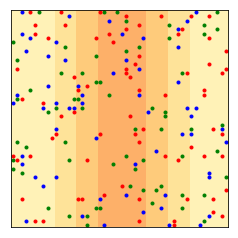

In [60]:
env = SugarscapeTemp(50,num_agents=200, sugarpeaks=sugarpeaksVert)
viewer = SugarscapeViewerTemp(env)

anim  =  viewer.animate(frames=300)

In [61]:
anim

That is the first simple sugarscape within this Case study. Even from the start the animal nature of the agents can be seen as they start to slowly move from their initial positions to the high sugar concentrated band in the middle of the environment. This also demonstrate that the code is working as intended. The agents moving towards the highest sugar point they can see, which results in them clumping together in the highest sugar zone as the simulation progresses.

From this point each chapter will focus on expanding the basic set of rules that have been defined to allow an analysis explaination of certain properties seen within our own enviroment and societies. 

The first of which will be establishment of death for our little world to examine carry capacity.

# Chapter 1 - Life and Death on the Sugarscape

Carrying capacity is defined in the oxford dictionary to be "The number of people, animals, or crops which a region can support without environmental degradation". In other words, it is can be considered the limit or maximum number of individuals that are sustainable over a prolonged period within a given region. In this section of the case study we will be using sugarscape to study carry capacity by varying the amount of high sugar zones within the environment. It would be expected that such an increase in sugar production would result in an increase in the number of induvial that the area can sustain. To test this a sugarscape can be created at a considerably higher population, much greater than the potential carrying capacity, and observations could be made as the agents run out of food. However, there is one problem with this and that is the lack of appropriate rules within our current set to model the effects of "death" and "starvation" or their effective equivalent within the sugarscape world.

## The Rule of Death
To model the effects of starvation and death the simulation only requires the addition of one agent-agent rule to the current set within the simulation. The rule is:

>If an agent has 0 or less sugar within its reserves at any given time step it is removed from the simulation.

This simple rule should be enough to model the effect of overpopulation and carry capacity. In addition, it doesn't provide any additional complexities that might manipulate the effects of the simple analysis. 

To add this all into the code we will be adding function called _is starving_ to our _Agent_ class, that will be activated during each time step. It simply returns whether an agent has 0 sugar or less in its reserve. This is then used in a modified step method to decide whether the agent should be considered "dead" and removed from the simulation. The code below will implement these changes into our two classes.     

In [338]:
class Agent:
    
    def __init__(self, loc, params):
        """Creates a new agent at the given location.
        
        loc: tuple coordinates
        params: dictionary of parameters
        """
        self.loc = tuple(loc)
        self.age = 0
        #self.color = 'red'
        # extract the parameters
        max_vision = params.get('max_vision', 6)
        max_metabolism = params.get('max_metabolism', 4)
        min_lifespan = params.get('min_lifespan', 10000)
        max_lifespan = params.get('max_lifespan', 10000)
        min_sugar = params.get('min_sugar', 5)
        max_sugar = params.get('max_sugar', 25)
        
        # choose attributes
        self.vision = np.random.randint(1, max_vision+1)
        self.metabolism = round(np.random.uniform(1, max_metabolism))
        self.lifespan = np.random.uniform(min_lifespan, max_lifespan)
        self.sugar = np.random.uniform(min_sugar, max_sugar)
        self.color = self.agent_color()

    def step(self, env):
        """Look around, move, and harvest.
        
        env: Sugarscape
        """
        self.loc = env.look_around(self.loc, self.vision)
        self.sugar += env.harvest(self.loc) - self.metabolism
        self.age += 1

    def is_starving(self):
        """Checks if sugar has gone negative."""
        return self.sugar < 0

    def agent_color(self):
        if self.metabolism == 2: 
            return 'blue'
        elif self.metabolism == 3:
            return 'purple'
        elif self.metabolism == 4:
            return 'red' 
        else: 
            return'green'

In [550]:
class Sugarscape(Cell2D):
    """Represents an Epstein-Axtell Sugarscape."""
    
    def __init__(self, n, **params):
        """Initializes the attributes.

        n: number of rows and columns
        params: dictionary of parameters
        """
        self.n = n
        self.params = params
        
        # track variables
        self.agent_count_seq = []
        self.grow_rate = params.get('growth_rate', 4)
        self.sugarpeaks = params.get('sugarpeaks', [[15,15],[35,35]])
        self.capacity,self.higher_capacity_locations  = self.make_capacity()
        #self.higher_capacity_locations
        
        # initially all cells are at capacity
        self.array = self.capacity.copy()
        
        # make the agents
        self.make_agents()
        #self.agents = self.make_agents()
        
        
    def make_capacity(self):
        """Makes the capacity array."""
        
        # compute the distance of each cell from the peaks. 
        x = np.arange(self.n)
        rows, cols = np.meshgrid(x, x, indexing='ij')
        
        # each cell in `rows` contains its own `i` coordinate
        # each cell in `cols` contains its `j` coordinate
        # creates the sugar peaks at this positions
        distHypots = []
        dist = np.hypot(rows-self.sugarpeaks[0][0], cols-self.sugarpeaks[0][1])
        for sugarpeakPos in self.sugarpeaks:
            distHypots.append(np.hypot(rows-sugarpeakPos[0], cols-sugarpeakPos[1]))
        
        for distHypot in distHypots:
            dist = np.minimum(dist, distHypot)
        
        # cells in the capacity array are set according to dist from peak
        a = np.zeros((self.n, self.n), np.float)
        a[dist>=17] = 0
        a[dist<17] = 1
        a[dist<13] = 2
        a[dist<9] = 3
        a[dist<5] = 4
        higher_capacity_counter = len(a[dist<6] == 4)
        
        return a, higher_capacity_counter 
        
    def make_agents(self):
        """Makes the agents."""
        
        # determine where the agents start and generate locations
        n, m = self.params.get('starting_box', self.array.shape)
        locs = make_locs(n, m)
        np.random.shuffle(locs)

        # make the agents
        num_agents = self.params.get('num_agents', 400)
        self.agents = [Agent(locs[i], self.params) 
                       for i in range(num_agents)]
        
        # keep track of which cells are occupied
        self.occupied = set(agent.loc for agent in self.agents)
        return self.agents
            
    def grow(self):
        """Adds sugar to all cells and caps them by capacity."""
        grow_rate = self.params.get('grow_rate', self.grow_rate)
        self.array = np.minimum(self.array + grow_rate, self.capacity)
        
    def look_around(self, center, vision):
        """Finds the visible cell with the most sugar.
        
        center: tuple, coordinates of the center cell
        vision: int, maximum visible distance
        
        returns: tuple, coordinates of best cell
        """
        # find all visible cells
        locs = make_visible_locs(vision)
        locs = (locs + center) % self.n
        
        # convert rows of the array to tuples
        locs = [tuple(loc) for loc in locs]
        
        # select unoccupied cells
        empty_locs = [loc for loc in locs if loc not in self.occupied]
        
        # if all visible cells are occupied, stay put
        if len(empty_locs) == 0:
            return center
        
        # look up the sugar level in each cell
        t = [self.array[loc] for loc in empty_locs]
        
        # find the best one and return it
        # (in case of tie, argmax returns the first, which
        # is the closest)
        i = np.argmax(t)
        
        return empty_locs[i]
    
    def harvest(self, loc):
        """Removes and returns the sugar from `loc`.
        
        loc: tuple coordinates
        """
        sugar = self.array[loc]
        self.array[loc] = 0
        return sugar
    
    def step(self):
        """Executes one time step."""
        replace = self.params.get('replace', False)
        
        # loop through the agents in random order
        random_order = np.random.permutation(self.agents)
        for agent in random_order:
            
            # mark the current cell unoccupied
            self.occupied.remove(agent.loc)
            
            # execute one step
            agent.step(self)

            # if the agent is dead, remove from the list
            if agent.is_starving():
                self.agents.remove(agent)
                if replace:
                    self.add_agent()
            else:
                # otherwise mark its cell occupied
                self.occupied.add(agent.loc)

        # update the time series
        self.agent_count_seq.append(len(self.agents))
        
        # grow back some sugar
        self.grow()
        return len(self.agents)
    
    def add_agent(self):
        """Generates a new random agent.
                
        returns: new Agent
        """
        new_agent = Agent(self.random_loc(), self.params)
        self.agents.append(new_agent)
        self.occupied.add(new_agent.loc)
        return new_agent
    
    def random_loc(self):
        """Choose a random unoccupied cell.
        
        returns: tuple coordinates
        """
        while True:
            loc = tuple(np.random.randint(self.n, size=2))
            if loc not in self.occupied:
                return loc
            
    def agents_metabolism_counter(self):
        low_met = 0
        mid_met = 0
        high_met = 0
        for agent in self.agents:
            if agent.color=='green' or agent.color=='purple':
                low_met = low_met+1
            elif agent.color=='blue':
                mid_met=mid_met+1
            elif agent.color=='red':
                high_met=high_met+1
        return low_met, mid_met, high_met

In [416]:
class SugarscapeViewer(Cell2DViewer):
    """Generates visualization and animation of Sugarscape."""
    
    cmap = plt.get_cmap('YlOrRd')
    
    options = dict(interpolation='none', alpha=0.8,
                   vmin=0, vmax=9)
    
    def draw(self, grid=False):
        """Draws the array and any other elements.
        
        grid: boolean, whether to draw grid lines
        """
        self.draw_array(self.viewee.array, origin='lower')
        self.draw_agents()

    def draw_agents(self):
        """Plots the agents.
        """
        self.p = []
        
        xsg, ysg, do_plotting = self.get_coords('red')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            size = len(self.p)
            self.points = plt.plot(xsg, ysg, '.', color='red', markersize =350/self.viewee.n)[0]
            self.p.append(self.points)
            
        xs, ys, do_plotting = self.get_coords('purple')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='purple', markersize =350/self.viewee.n)[0]
            self.p.append(self.points)
            
        xs, ys, do_plotting = self.get_coords('blue')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='blue', markersize =350/self.viewee.n)[0]
            
            self.p.append(self.points)
            
        xs, ys, do_plotting = self.get_coords('green')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='green', markersize =350/self.viewee.n)[0]
            self.p.append(self.points)
        
    def animate_func(self, i):
        """Draws one frame of the animation."""
        Cell2DViewer.animate_func(self, i)
        
        xs, ys, do_anim = self.get_coords('red')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[0].set_data(np.array([xs, ys]))
            
        xs, ys, do_anim = self.get_coords('purple')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[1].set_data(np.array([xs, ys]))
            
        xs, ys, do_anim = self.get_coords('blue')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[2].set_data(np.array([xs, ys]))
            
        xs, ys, do_anim = self.get_coords('green')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[3].set_data(np.array([xs, ys]))
        """
        xs, ys = self.get_coords('all')
        self.points.set_data(np.array([xs, ys]))"""
        return self.im, self.p #oints
           
    def get_coords(self, color):
        """Gets the coordinates of the agents.
        
        Transforms from (row, col) to (x, y).
        
        returns: tuple of sequences, (xs, ys)
        """
        xs = [[]]
        ys = [[]]
        agents = self.viewee.agents
        if color=='all':
            rows, cols = np.transpose([agent.loc for agent in agents])
            xs = cols + 0.5
            ys = rows + 0.5
            return xs,ys
        
        do_transpose = False
        for agent in agents:
            if agent.color==color:
                do_transpose = True
                break

        if do_transpose:
            rows, cols = np.transpose([agent.loc for agent in agents if agent.color==color])
            xs = cols + 0.5
            ys = rows + 0.5
            
        return xs, ys, do_transpose

### The parameters of a world
To conduct our study on carry capacity certain variable and conditions will be kept at a constant throughout entirety of the simulations and study. These variables are as follows:
    - 50 unit world size.
    - World will be populated with 600 agents on initial creation.
    - Random position assignment for all agents on initial creation.
    - Random vision assignment for the agents (between 1 and 6 vision level)
    - Random metabolism assignment for the agents (between 1 and 4 metabolism level)
    - All agents will start with a random amount of sugar between 5 and 25.
    - Full capacity growth of the sugar after being harvested.

However, to provide varied results some parameters will need to be changed. In these experiments that will be the values within the capacity array of the sugar within the simulation. By varying the number of peaks, we effectively increase the amount of maximum sugar available for harvest per time step. In theory there should be a maximum carry capacity equal to the sum of the sugar capacity array divided by the average metabolism level for all agents. 

For the simulations will use the one to five peak environments that were created back in chapter 0 of this case study, figures 2. For ease of convince these will be displayed again in their initial configurations in figure 5. To aid with these displays the total maximum sugar, sum of sugar capacity array, will be graphed and displayed as well in figure 6.

In [473]:
sugarpeaksA = [ [35,35] ]  # One main central sugar peak
sugarpeaksB = [ [19,19], [51,51] ] # Standard sugar peaks as book replicates it
sugarpeaksC = [ [35,19], [51,51], [19,51] ] # 3 sugar peaks
sugarpeaksD = [ [19,19], [51,19], [19,51], [51,51] ] # 4 sugar peaks
sugarpeaksE = [ [16,16], [54,16], [35,35], [16,54], [54,54] ] # 5 sugar peaks

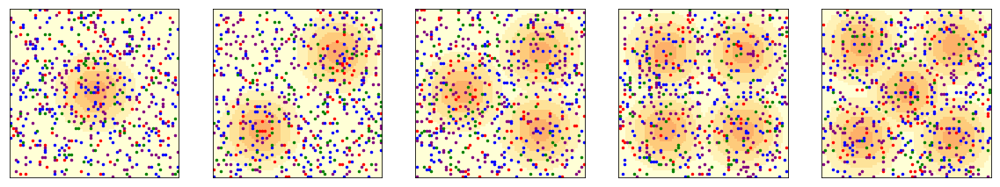

In [551]:
envA = Sugarscape(70, num_agents=600, sugarpeaks=sugarpeaksA)
envB = Sugarscape(70, num_agents=600, sugarpeaks=sugarpeaksB)
envC = Sugarscape(70, num_agents=600, sugarpeaks=sugarpeaksC)
envD = Sugarscape(70, num_agents=600, sugarpeaks=sugarpeaksD)
envE = Sugarscape(70, num_agents=600, sugarpeaks=sugarpeaksE)

fig = plt.figure(figsize = (20,20))

ax1 = fig.add_subplot(1,5,1)
viewerA  =  SugarscapeViewer(envA)
viewerA.draw()

ax2 = fig.add_subplot(1,5,2)
viewerB  =  SugarscapeViewer(envB)
viewerB.draw()

ax3 = fig.add_subplot(1,5,3)
viewerC  =  SugarscapeViewer(envC)
viewerC.draw()

ax4 = fig.add_subplot(1,5,4)
viewerD  =  SugarscapeViewer(envD)
viewerD.draw()

ax5 = fig.add_subplot(1,5,5)
viewerE  =  SugarscapeViewer(envE)
viewerE.draw()



___Figure 5:___ Random inital conditions from 1 to 5 peaks


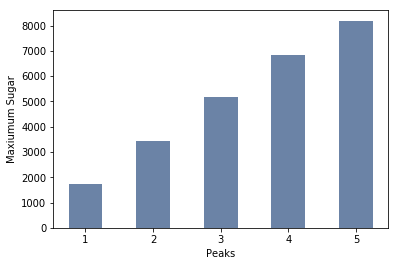

In [552]:
max_sugar = [np.sum(envA.capacity),
             np.sum(envB.capacity),
             np.sum(envC.capacity),
             np.sum(envD.capacity),
             np.sum(envE.capacity)];

thinkplot.Bar([0.75,1.75,2.75,3.75,4.75],max_sugar, width=0.5, align='edge')
thinkplot.Config(xlabel='Peaks',
                 ylabel='Maxiumum Sugar',
                 legend=False)

___Figure 6:___ Maximum possible sugar to be supplied each step for given number of peaks.

The above figure clearly shows an increasing total number of sugar per peak. Although it is not completely linear, 5 peaks is not entirely linear, this is okay for the experiments that will be conducted as it will be still possible to observe the effective change in carry capacity. 

With these in place it is possible for the conduction of the experiments. However, there will be an initial check of the random variable that were assigned and provide to checking the code. This will be done by viewing the accumulative distribution of agent vision, metabolism, and initial sugar quantities to ensure that they were coded correctly and that the random number generator is not bias. 

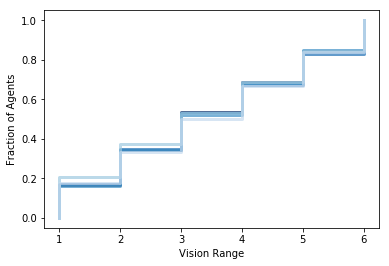

In [82]:
cdfA = Cdf(agent.vision for agent in envA.agents)
cdfB = Cdf(agent.vision for agent in envB.agents)
cdfC = Cdf(agent.vision for agent in envC.agents)
cdfD = Cdf(agent.vision for agent in envD.agents)
cdfE = Cdf(agent.vision for agent in envE.agents)
thinkplot.Cdf(cdfA)
thinkplot.Cdf(cdfB)
thinkplot.Cdf(cdfC)
thinkplot.Cdf(cdfD)
thinkplot.Cdf(cdfE)
thinkplot.Config(ylabel='Fraction of Agents',
                 xlabel='Vision Range',
                 legend=True)

___Figure 7:___ Accumulative distribution of agents by vision distance.


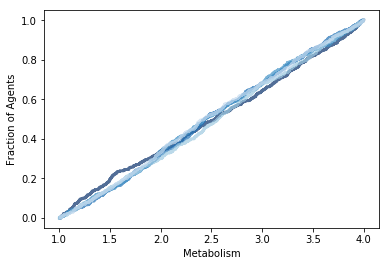

In [83]:
cdfA = Cdf(agent.metabolism for agent in envA.agents)
cdfB = Cdf(agent.metabolism for agent in envB.agents)
cdfC = Cdf(agent.metabolism for agent in envC.agents)
cdfD = Cdf(agent.metabolism for agent in envD.agents)
cdfE = Cdf(agent.metabolism for agent in envE.agents)
thinkplot.Cdf(cdfA)
thinkplot.Cdf(cdfB)
thinkplot.Cdf(cdfC)
thinkplot.Cdf(cdfD)
thinkplot.Cdf(cdfE)
thinkplot.Config(ylabel='Fraction of Agents',
                 xlabel='Metabolism',
                 legend=True)

___Figure 8:___ Accumulative distribution of agent metabolism.


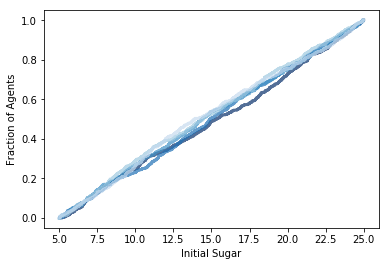

In [84]:
cdfA = Cdf(agent.sugar for agent in envA.agents)
cdfB = Cdf(agent.sugar for agent in envB.agents)
cdfC = Cdf(agent.sugar for agent in envC.agents)
cdfD = Cdf(agent.sugar for agent in envD.agents)
cdfE = Cdf(agent.sugar for agent in envE.agents)
thinkplot.Cdf(cdfA)
thinkplot.Cdf(cdfB)
thinkplot.Cdf(cdfC)
thinkplot.Cdf(cdfD)
thinkplot.Cdf(cdfE)
thinkplot.Config(ylabel='Fraction of Agents',
                 xlabel='Initial Sugar',
                 legend=True)

___Figure 9:___ Accumulative distribution of agent initial sugar total.

Figures 7-9 demonstrate a typical distribution of random values that was to be expected. All sets of values are reasonably straight with some deviates from the average value but not to any alarming degree. In addition, the distributions show linear or step increases indicating an even distribution of agents within each distinct whole region per category. However, due to the limited number of random values there should still be the chance that our random number generator is not performing as expected. So, solve this the initial conditions will be generated 10,000 times and the average of all the agents generated taken and calculated. We should expect to see averages being equal to the following values for each category. 
    - Vision:        3.5
    - Metabolism:    2.5
    - Initial Sugar: 15.0

In [115]:
avg_vision     = 0
avg_metabolism = 0
avg_sugar      = 0

for i in range(0,10000):
    env = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksA)
    for agent in env.agents:
        avg_vision     += agent.vision
        avg_metabolism += agent.metabolism
        avg_sugar      += agent.sugar

avg_vision     /= 6000000
avg_metabolism /= 6000000
avg_sugar      /= 6000000

print('average vision = {0}\n average metabolism = {1}\n average initial sugar = {2}'.format(
      avg_vision, avg_metabolism, avg_sugar))

average vision = 3.500891
 average metabolism = 2.499931114283762
 average initial sugar = 15.002117125311507


Given that all values calculated were within 0.003 of the calculated averages, it provides certainty that the code and random number generator is operating correctly. Especially with this graphical and extensive checking.

### Running a world
With the initial conditions in place we will run all the different environments for 300 steps and observe the results. To help visualization of the results, all the steps will be converted into animations for easy viewing. The image below each animation is the result of the simulation after 300 steps. After this the simulations will be reconducted 100 times to gather the average population per step time. The reason for the extensive repetition is that there is a variance in the maximum carry capacity depending on the initial condition of the experiment. To get a better overall understanding the average is taken.

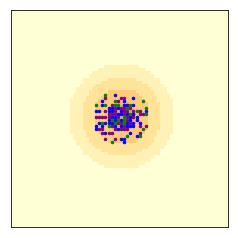

In [509]:
animA  =  viewerA.animate(frames=300)
animA

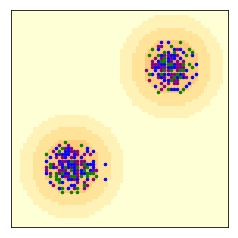

In [510]:
animB  =  viewerB.animate(frames=300)
animB

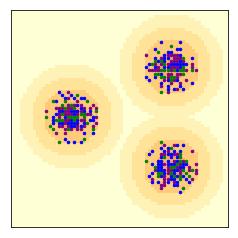

In [511]:
animC  =  viewerC.animate(frames=300)
animC

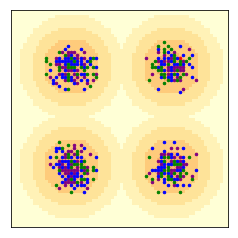

In [512]:
animD  =  viewerD.animate(frames=300)
animD

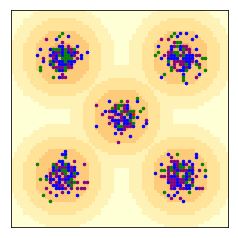

In [513]:
animE  =  viewerE.animate(frames=300)
animE

In [514]:
pop_averages = [envA.agent_count_seq, 
               envB.agent_count_seq,
               envC.agent_count_seq,
               envD.agent_count_seq,
               envE.agent_count_seq]

for i in range(0, 99):
    envA = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksA)
    envB = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksB)
    envC = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksC)
    envD = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksD)
    envE = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksE)
    
    for j in range(0,299):
        envA.step()
        envB.step()
        envC.step()
        envD.step()
        envE.step()
    
    if i%10 == 0:
        print('simulations performed: {0}'.format(i))
        
    pop_averages[0] = np.add(pop_averages[0], envA.agent_count_seq)
    pop_averages[1] = np.add(pop_averages[1], envB.agent_count_seq)
    pop_averages[2] = np.add(pop_averages[2], envC.agent_count_seq)
    pop_averages[3] = np.add(pop_averages[3], envD.agent_count_seq)
    pop_averages[4] = np.add(pop_averages[4], envE.agent_count_seq)

simulations performed: 0
simulations performed: 10
simulations performed: 20
simulations performed: 30
simulations performed: 40
simulations performed: 50
simulations performed: 60
simulations performed: 70
simulations performed: 80
simulations performed: 90


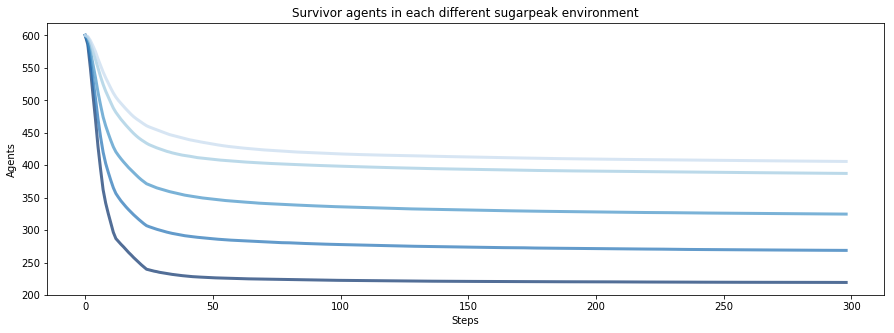

In [515]:
results = []

for i in range(0, 5):
    temp = [];
    for j in range(0,299):
        temp.append(pop_averages[i][j]/100)
    results.append(temp.copy())

fig = plt.figure(figsize = (15,5))

thinkplot.plot(results[0])
thinkplot.plot(results[1])
thinkplot.plot(results[2])
thinkplot.plot(results[3])
thinkplot.plot(results[4])
thinkplot.Config(title = 'Survivor agents in each different sugarpeak environment',
                 ylabel='Agents',
                 xlabel='Steps',
                 legend=True)

___Figure 9:___ Number of Agents still "alive" over 300 steps. Lighter colour indicates more peaks

From all the animations it is observable that the agents quickly locate to the high sugar region, this is the same effect that was observed in the initial sugarscape that was created back in chapter 0. However, unlike the initial sugarscape those unfortunate agents who do not find high peak area quickly enough or just must high of metabolism quickly die off. This is most notable in the outer regions, and environments with few peaks, as the number of red agents, indicating 4 metabolism, quickly die off as the probability of surviving in these locations for those agents are low. Eventually as time progresses this results in only the green agents being left in the outer regions. The green agents are those with the lowest metabolism of 1. This seems to indicate a kind of natural selection being presented in the simulation. The agents with higher metabolisms or those that are least efficient are killed off the quickest. This then decreases the average metabolism of the group and helps to raise the carrying capacity of the environment. In addition, we can also see this effect being less prevalent in environments with a naturally higher carrying capacity, those environments with 4 or 5 peaks. Further indicating that this natural selection only occurs when the need for greater efficiency is required. This effect will be studied further in the next section. 

Figure 9 represents the final average population values over the 300 time steps. There is a noticeable decrease in population over time for each of the environments. This would seem to indicate the carry capacity of the environment; however this does not seem to match up with the availability of sugar in the environment. Figure 6 showed a linear trend for the maximum producible sugar in the environment, yet figure 9 indicates a non-linear relationship. There are two explanations for this. 

First is that the maximum carrying capacity for the environment is not utilizable for all the agents initially placed in the environment. This is especially true for the outer regions as has already been identified. The local carry capacities of these outer regions is 0 as they generate no sugar. This then kills off the agents in this region before they have any time to find a better zone. Since the environments with less peaks have considerably greater quantity of this area it would help to explain the rapid drop off in population seen.

The second reason is similar to the first. Certain agents require environments with a greater quantity of sugar to survive long term. This is most prevalent for agents with metabolism 4. They are extremely limited in their choice of survivable environment. Any areas not at the top of sugar peaks will result in their eventual death. If they are pushed off these zones due to too much competition they will have to find a way back in quickly or soon due off. This would also help to explain the slow drop off after the initial great plunge as more and more agents flood into the best zones. As those unlucky agents get pushed off those that require more resources die off before they get a chance to get back into the zone. This suggest that the agents are not naturally sharing out the zone at optimal efficiency with a lot of agents that could easily survive in other areas displacing those that need this current zone to survive. Once again, this draw evolutionary concepts such as "Darwin survival of the fittest". As with the first issue, this second issue is also considerably less prevalent in higher the number of peaks as proportionally greater quantity of best land, so compaction goes down and more of agents with higher metabolisms can survive.

To mitigate these issues the code will have to be changed by adding in the ability for birth to occur as well as death. This will help to increase the population and allow for the actual carry capacity to be meet. It will also allow for the opportunity of the evolutionary process to become more noticeable as the simulation progresses.  

### Overpopulation
The next set of experiments will explore the same concept as before but with the ability for the population to bounce back and reach the carry capacity. This will be done in the code by randomly copying a agent of the alive population and placing them next to the that agent if they have room to do so. Then as not add an additional supply of sugar into the environment. The sugar of the randomly selected agent is halved between the two. How many times this occurs will depend on the population and will follow this equation 

$number Of New Agents = (Number Of Agents / Reproduction Rate)+1$

The addition of one extra agent at the end ensures that all populations will have a growth rate of some kind, even if the population is only 1 individual. For our experiments the reproduction rate is 25 agents per birth. This was found to be a good midway point between the simulations having to run too long and too fast of a birth rate to manipulate the results. 

The following code implements the changes described. The new code has been highlighted in some comments.

In [554]:
class Sugarscape(Cell2D):
    """Represents an Epstein-Axtell Sugarscape."""
    
    def __init__(self, n, **params):
        """Initializes the attributes.

        n: number of rows and columns
        params: dictionary of parameters
        """
        self.n = n
        self.params = params
        
        # track variables
        self.agent_count_seq = []
        self.grow_rate = params.get('growth_rate', 4)
        self.sugarpeaks = params.get('sugarpeaks', [[15,15],[35,35]])
        self.birth_rate = params.get('agents_per_birth', 100)
        self.capacity,self.higher_capacity_locations  = self.make_capacity()
        #self.higher_capacity_locations
        
        # initially all cells are at capacity
        self.array = self.capacity.copy()
        
        # make the agents
        self.make_agents()
        #self.agents = self.make_agents()
        
        
    def make_capacity(self):
        """Makes the capacity array."""
        
        # compute the distance of each cell from the peaks. 
        x = np.arange(self.n)
        rows, cols = np.meshgrid(x, x, indexing='ij')
        
        # each cell in `rows` contains its own `i` coordinate
        # each cell in `cols` contains its `j` coordinate
        # creates the sugar peaks at this positions
        distHypots = []
        dist = np.hypot(rows-self.sugarpeaks[0][0], cols-self.sugarpeaks[0][1])
        for sugarpeakPos in self.sugarpeaks:
            distHypots.append(np.hypot(rows-sugarpeakPos[0], cols-sugarpeakPos[1]))
        
        for distHypot in distHypots:
            dist = np.minimum(dist, distHypot)
        
        # cells in the capacity array are set according to dist from peak
        a = np.zeros((self.n, self.n), np.float)
        a[dist>=13] = 0
        a[dist<13] = 1
        a[dist<10] = 2
        a[dist<7] = 3
        a[dist<4] = 4
        higher_capacity_counter = len(a[dist<6] == 4)
        
        return a, higher_capacity_counter 
        
    def make_agents(self):
        """Makes the agents."""
        
        # determine where the agents start and generate locations
        n, m = self.params.get('starting_box', self.array.shape)
        locs = make_locs(n, m)
        np.random.shuffle(locs)

        # make the agents
        num_agents = self.params.get('num_agents', 400)
        self.agents = [Agent(locs[i], self.params) 
                       for i in range(num_agents)]
        
        # keep track of which cells are occupied
        self.occupied = set(agent.loc for agent in self.agents)
        return self.agents
            
    def grow(self):
        """Adds sugar to all cells and caps them by capacity."""
        grow_rate = self.params.get('grow_rate', self.grow_rate)
        self.array = np.minimum(self.array + grow_rate, self.capacity)
        
    def look_around(self, center, vision):
        """Finds the visible cell with the most sugar.
        
        center: tuple, coordinates of the center cell
        vision: int, maximum visible distance
        
        returns: tuple, coordinates of best cell
        """
        # find all visible cells
        locs = make_visible_locs(vision)
        locs = (locs + center) % self.n
        
        # convert rows of the array to tuples
        locs = [tuple(loc) for loc in locs]
        
        # select unoccupied cells
        empty_locs = [loc for loc in locs if loc not in self.occupied]
        
        # if all visible cells are occupied, stay put
        if len(empty_locs) == 0:
            return center
        
        # look up the sugar level in each cell
        t = [self.array[loc] for loc in empty_locs]
        
        # find the best one and return it
        # (in case of tie, argmax returns the first, which
        # is the closest)
        i = np.argmax(t)
        
        return empty_locs[i]
    
    def harvest(self, loc):
        """Removes and returns the sugar from `loc`.
        
        loc: tuple coordinates
        """
        sugar = self.array[loc]
        self.array[loc] = 0
        return sugar
    
    def step(self):
        """Executes one time step."""
        replace = self.params.get('replace', False)
        
        # loop through the agents in random order
        random_order = np.random.permutation(self.agents)
        for agent in random_order:
            
            # mark the current cell unoccupied
            self.occupied.remove(agent.loc)
            
            # execute one step
            agent.step(self)

            # if the agent is dead, remove from the list
            if agent.is_starving():
                self.agents.remove(agent)
                if replace:
                    self.add_agent()
            else:
                # otherwise mark its cell occupied
                self.occupied.add(agent.loc)

        # update the time series
        self.agent_count_seq.append(len(self.agents))
        
        # add new agents through birth///////////////////////////////////////////////////////////////////
        length = len(self.agents);
        randStart = np.random.randint(0,high=length)
        count = randStart
        for i in range(0, (len(self.agents)//self.birth_rate) + 1):
            while(True):
                agent = self.agents[count]
                count = (count + 1)%length
                
                free_slot = self.look_around(agent.loc, 1)

                if free_slot != agent.loc:
                    self.add_agent_copy(agent, free_slot)
                    break
                
                if count == randStart:
                    break
            if count == randStart:
                break
        # add new agents through birth End///////////////////////////////////////////////////////////////
        
        # grow back some sugar
        self.grow()
        return len(self.agents)
    
    def add_agent(self):
        """Generates a new random agent.
                
        returns: new Agent
        """
        new_agent = Agent(self.random_loc(), self.params)
        self.agents.append(new_agent)
        self.occupied.add(new_agent.loc)
        return new_agent
    
    # This new method copies the stats from an existing agent to a new agent//////////////////////////////
    def add_agent_copy(self, agent, loc):
        new_agent = Agent(loc, self.params)
        self.agents.append(new_agent)
        self.occupied.add(loc)
        new_agent.vision = agent.vision
        new_agent.metabolism = agent.metabolism
        new_agent.color = agent.color
        new_agent.sugar = agent.sugar//2
        agent.sugar -= new_agent.sugar
    #////////////////////////////////////////////////////////////////////////////////////////////////////
    
    def random_loc(self):
        """Choose a random unoccupied cell.
        
        returns: tuple coordinates
        """
        while True:
            loc = tuple(np.random.randint(self.n, size=2))
            if loc not in self.occupied:
                return loc
            
    def agents_metabolism_counter(self):
        low_met = 0
        mid_met = 0
        high_met = 0
        for agent in self.agents:
            if agent.color=='green' or agent.color=='purple':
                low_met = low_met+1
            elif agent.color=='blue':
                mid_met=mid_met+1
            elif agent.color=='red':
                high_met=high_met+1
        return low_met, mid_met, high_met

With the code defined the next set of experiments can be conducted. However, it was found during experimentation that the previous environmental setup took too long computationally to run with the ability for the population to grow and expand. To help mitigate this, we have reduced the size of the peaks diameter. Each level of sugar production has had its diameter reduced by one. The new resulting max sugar production rates can be seen in figure 10, as you can see the overall ratio was maintained and due to the decrease in size we can properly fit the 5 peaks, resulting in a pure linear trend.

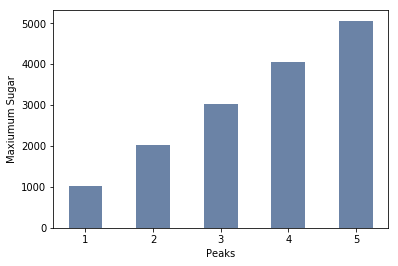

In [555]:
envA = Sugarscape(70, num_agents=600, sugarpeaks=sugarpeaksA, agents_per_birth=25)
envB = Sugarscape(70, num_agents=600, sugarpeaks=sugarpeaksB, agents_per_birth=25)
envC = Sugarscape(70, num_agents=600, sugarpeaks=sugarpeaksC, agents_per_birth=25)
envD = Sugarscape(70, num_agents=600, sugarpeaks=sugarpeaksD, agents_per_birth=25)
envE = Sugarscape(70, num_agents=600, sugarpeaks=sugarpeaksE, agents_per_birth=25)

max_sugar = [np.sum(envA.capacity),
             np.sum(envB.capacity),
             np.sum(envC.capacity),
             np.sum(envD.capacity),
             np.sum(envE.capacity)];

thinkplot.Bar([0.75,1.75,2.75,3.75,4.75],max_sugar, width=0.5, align='edge')
thinkplot.Config(xlabel='Peaks',
                 ylabel='Maxiumum Sugar',
                 legend=False)

___Figure 10:___ Maximum sugar production rate per peak.

To continue the same process as last time the simulation will run for 300 steps with 600 actors initially. For these experiments the birth rate has been set at 25 agents per new agent each time step. Similar to last time several animations will be created, to visualize the trend occurring. Then the process will be repeated 100 times and the population averaged out. However, previously it was identified some selection processes going on and to capture this there will also be two additional graphs recording the average metabolism and average vision of all the agents at each time step over the 100 runs.

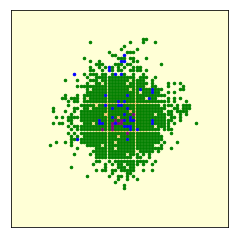

In [532]:
viewerA  =  SugarscapeViewer(envA)
animA  =  viewerA.animate(frames=300)
animA

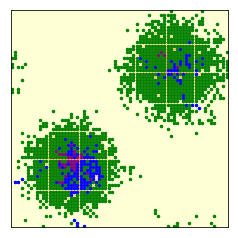

In [533]:
viewerB  =  SugarscapeViewer(envB)
animB  =  viewerB.animate(frames=300)
animB

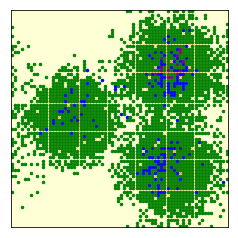

In [534]:
viewerC  =  SugarscapeViewer(envC)
animC  =  viewerC.animate(frames=300)
animC

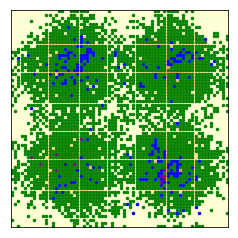

In [535]:
viewerD  =  SugarscapeViewer(envD)
animD  =  viewerD.animate(frames=300)
animD

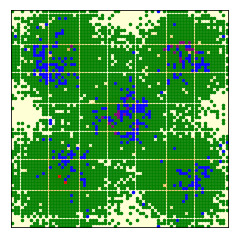

In [536]:
viewerE  =  SugarscapeViewer(envE)
animE  =  viewerE.animate(frames=300)
animE

In [530]:
peaks = [sugarpeaksA, sugarpeaksB, sugarpeaksC, sugarpeaksD, sugarpeaksE]

avg_pop = [] 
avg_met = []
avg_vis = []

for i in range(0,5):
    
    temp_pop = np.zeros(300)
    temp_met = np.zeros(300)
    temp_vis = np.zeros(300)
    for j in range(0,100):
        env = Sugarscape(70, num_agents=600, sugarpeaks=peaks[i], agents_per_birth=25)
        for k in range(0, 300):
            env.step()
            temp_pop[k] += len(env.agents)
            temp_met[k] += sum(agent.metabolism for agent in env.agents)/len(env.agents)
            temp_vis[k] += sum(agent.vision for agent in env.agents)/len(env.agents)
            
            if(j == 99):
                temp_pop[k] /= 100
                temp_met[k] /= 100
                temp_vis[k] /= 100
        #these experiments take a while to run and knowing the progress is helpful.        
        if(j%10 == 0):
            print(j)
    avg_pop.append(temp_pop)
    avg_met.append(temp_met)
    avg_vis.append(temp_vis)

0
10
20
30
40
50
60
70
80
90
0
10
20
30
40
50
60
70
80
90
0
10
20
30
40
50
60
70
80
90
0
10
20
30
40
50
60
70
80
90
0
10
20
30
40
50
60
70
80
90


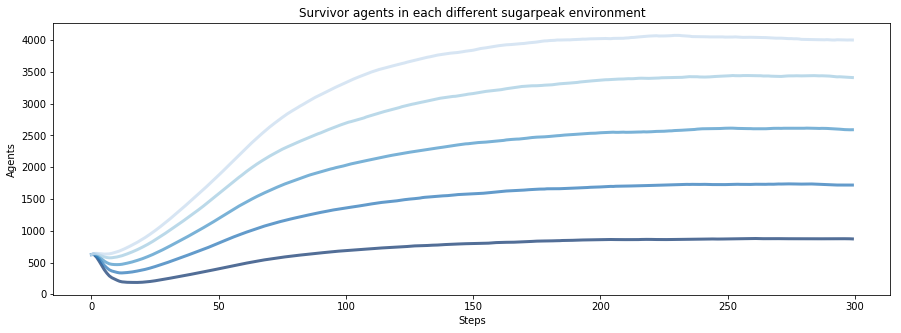

In [560]:
fig = plt.figure(figsize = (15,5))
for i in range(0,5):
    thinkplot.plot(avg_pop[i])
thinkplot.Config(title = 'Survivor agents in each different sugarpeak environment',
                 ylabel='Agents',
                 xlabel='Steps',
                 legend=True)

__Figure 11:___ Average number of agents at each time step.Lighter colour means more peaks 

From figure 11 we see a much more interesting trend then there was previously in figure 9. There is the noticeable decline from before, but the population quickly expands and seems to level off. That main change gives the first real taste of an actual carrying capacity of the environment, as the closer you get to the carry capacity the harder it is for the population to increase. To get a more equal comparison of the environments and to judge whether or not sugar production is an important part in what effect the carry capacity, we took the average population of the last 20 time steps and used that to divide the maximum sugar production rate. This would give the average sugar per agent and as such would be compared to the average metabolism of each agent in the last 20 time steps. Further discussion on this will be done below under figure 12, which shows the results of this analysis.

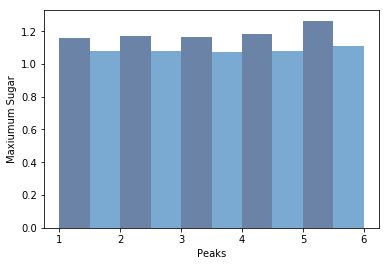

In [559]:
results  = np.zeros(5)
results2 = np.zeros(5)
for j in range(0, 5):
    for i in range(280, 300):
        results[j]  += avg_pop[j][i]
        results2[j] += avg_met[j][i]
        if(i == 299):
            results[j]  /= 20
            results2[j] /= 20 
            results[j] = max_sugar[j]/results[j]
            
thinkplot.Bar([1,2,3,4,5],results, width=0.5, align='edge')
thinkplot.Bar([1.5,2.5,3.5,4.5,5.5],results2, width=0.5, align='edge')
thinkplot.Config(xlabel='Peaks',
                 ylabel='Maxiumum Sugar',
                 legend=False)

___Figure 12:___ Dark blue: sugar production rate per agent and average metabolism of each agent in last 20 steps.

Figure 12 indicates a very linear trend and seems to indicate a very stable relationship between sugar and the carry capacity of the environment and seems to line up nicely with our initial proposition that sugar production rate will determine the number of agents. However, there is a noticeable increase for 5 peaks compared to all the other peaks from 1 to 4. This is probably due to another limitation to the growth and expansion of agents within the environment which is space. If you observe the animation for the 5 peaks, compared to the other 3 you notice a significant lack of space. In addition, the central peak doesn't have the capacity for agents to overflow onto the sides. These agents use their reserves of sugar to survive and either die or return to the sugar producing areas. This allows for a much higher efficiency as reserves are spent rather then conserved. Due to the limited nature of expansion for the 5th peak these agents cannot do this process as easy, resulting in higher rate of sugar per each agent. This also indicate that carry capacity is not a simple 1 off relationship between energy and number of survival members. That a variety of different constraints will effect the overall carrying capacity of the environment.

Another noticeable outcome is the slightly higher rate of sugar compared to the average metabolism of the agents. There would be an expected one to one ratio between the two if the agents reach the most efficient configuration. What this indicates, is a continuation of the selfish nature of an agents within a competitive field resulting in unequal distribution of sugar, as noticed before in the previous simulation without growth. Some agents around the center of the simulation would receive a lot more sugar than their metabolism would consume. As the average vision decreases during the end of the simulation, figure 13, these agents would be less and less likely to leave the higher sugar production zones and decreases their venturing into the risky areas of no sugar production. As such these agents will never use up their reserves of sugar and as such never allow other agents to utilize it the effective carrying capacity of the simulation drops. This results in the higher rate of sugar use per agent on average.

### Evoltion of agents

The next set of two graphs show the evolutionary process that the simuation produces due to the addition of population expansion. 

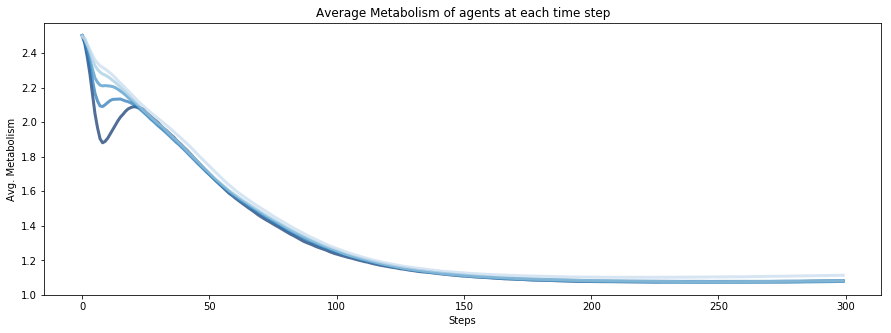

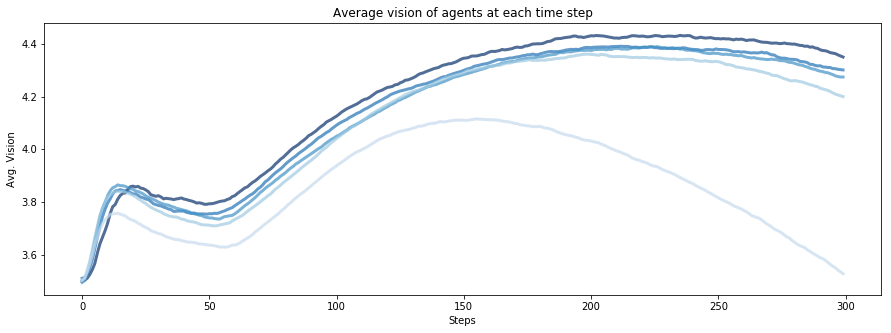

In [561]:

fig = plt.figure(figsize = (15,5))
for i in range(0,5):
    thinkplot.plot(avg_met[i])
thinkplot.Config(title = 'Average Metabolism of agents at each time step',
                 ylabel='Avg. Metabolism',
                 xlabel='Steps',
                 legend=True)

fig = plt.figure(figsize = (15,5))
for i in range(0,5):
    thinkplot.plot(avg_vis[i])
thinkplot.Config(title = 'Average vision of agents at each time step',
                 ylabel='Avg. Vision',
                 xlabel='Steps',
                 legend=True)

__Figure 13:___ Average metabolism and vision over each time step. Lighter colour means more peaks.

Figure 13 indicates the average metabolism and vision for the agents over all the 100 experiments at each time step. As predicted beforehand, there is a decrease of the average metabolism from the 2.5 average at the start to around 1.1 at the end of the simulations. Although these graphs are very similar after roughly 25 steps and differ drastically between 0 and 25. The reason for this is quite plan and that is that agents die at different rates due to their metabolism. It is expecting on average that the agents with metabolism 4 would die first, followed by metabolism 3, and so forth. Therefore, there would be first an expected drop in metabolism as the number of agents with high metabolism "die" first resulting in a noticeable decrease in the average metabolism. However, on the flip side, there is a point in which the agents with a lower metabolism die off too. This has the opposite effect and increases the average metabolism. Eventually all the agents outside the survival zone, areas without sugar production, die off returning the simulation to the same rough average. The reason for this returning to the average is that the metabolism trait is not required for early survival as there is plenty of sugar. 

This would also help to explain the different levels of drop off for different level of peaks if you observe the rates of population decline for each environment in figure 11. The environments with the lower number of peaks see the highest initial rate of population decline. As such they have a heightened effect of what is noted above and are more susceptible to the changes. This would also help to explain why zones with higher number of peaks have a slight, for 5 peaks considerably, lower average vision as this selection criteria are less prevalent as there is a greater chance for finding a sugar production area. 

However, no matter the environment after this initial decrease and increase, all environments follow an extremely similar trend. The reasoning is that agents have an even chance of finding the top peaks, resulting in an even distribution of metabolism. Then after that point each population at the peaks develops as its own separate ecological system due to the space and lack of travel between them. So the metabolism is independent of the number of peaks and the current environmental configurations.

With all these trends in place there is still a lack of explanation for the main observable trend, which is the constant decline of the average metabolism. The simple explanation is that agents tend toward the lowest metabolism because those agents are more likely to survive the higher competitive environment. This is the same as what was observed without population growth, but with population growth this effect can occur continuously until the population reaches the lowest possible value. In addition, there is considerable more territory in which agents with a metabolism of 1 can occupy and survive than another. As such their overall percentage of the population increases as they expand to more survivable land. This also helps to decrease the average metabolism and result in the trend we have observed. In some regards this trend can be observed in economical markets, as the more efficient companies can access a larger portion of the population due to their lower prices and still survive. As such they can growth to considerable dominance over companies that tender for more specific markets with higher production costs. 

The next plot in figure 13 shows the average vision range of each agent. Compared to metabolism we see a much more interesting trend. First off there is an observe increase, then a decrease and following this the graph proceeds into an ark shape. Who's end or leveling out is not observed in the 300 steps. To understand this, the graphs can be broken into 3 sections. First being between 0 and roughly 20, next section between roughly 20 and 60. The final section which is from roughly 60 to the end of the simulation.

The first sections noticeable increase is since agents with higher vison are much more likely to find the higher producing sugar areas than those that do not. As such, they are much more likely to survive the initial drop in population, which results in an increase in the average vision of the agents. Even without population growth taken into effect. 

In the second section, the opposite trend occurs. Those agents with high metabolism and low vision are much more likely to stay in the higher producing sugar areas than their high vision counter parts as competition increases for these areas. As such the vision slowly decreases as these higher vision agents move to the lower production areas they can see that are unoccupied. This is due to the code that forces agents to move off their original point even if it has higher production rate of sugar. As such lower vision agents survive and the average vision then proceeds to go down. 

Things get a lot more complicated in the thirds section. The increasing and decreasing trend is possibly since new agents are only created if there is an open space to the "parent" agent and as agents with more vision are likely to move to any open space, they will naturally migrate towards the outside of the competitive areas to those with more space. As such because they have more space they will be more likely chosen as "parent" for new agents and result in an increase in average vision. This does not happen indefinitely though as the population reaches the carry capacity these agents with high vision are more and more likely to find themselves on the edge of the survivable area and then entirely within the non-survivable areas with no sugar production. As these agents start to die off in increasing number they are less likely to reproduce. In addition, the lower vision agents slowly start to spread from the center and displace the agents with higher vision forcing them into lower production zones. As the higher vision agents are more likely to move to open vacant non-producing sugar zones that are vacant due to their deadliness of the area. As the simulation progress these agents start to die off and be slowly be replaced by lower vision agents as they spread. How long this trend will continue will be explore below.

In [571]:
avg_pop2 = []
avg_vis2 = []

for i in range(0,1):
    temp_pop = np.zeros(1500)
    temp_vis = np.zeros(1500)
    for j in range(0,100):
        env = Sugarscape(70, num_agents=600, sugarpeaks=peaks[i], agents_per_birth=25)
        for k in range(0, 1500):
            env.step()
            temp_pop[k] += len(env.agents)
            temp_vis[k] += sum(agent.vision for agent in env.agents)/len(env.agents)
            
            if(j == 99):
                temp_pop[k] /= 10
                temp_vis[k] /= 10
        #these experiments take a while to run and knowing the progress is helpful.        
        if(j%10 == 0):
            print(j)
    avg_vis2.append(temp_vis)
    avg_pop2.append(temp_pop)

0
10
20
30
40
50
60
70
80
90


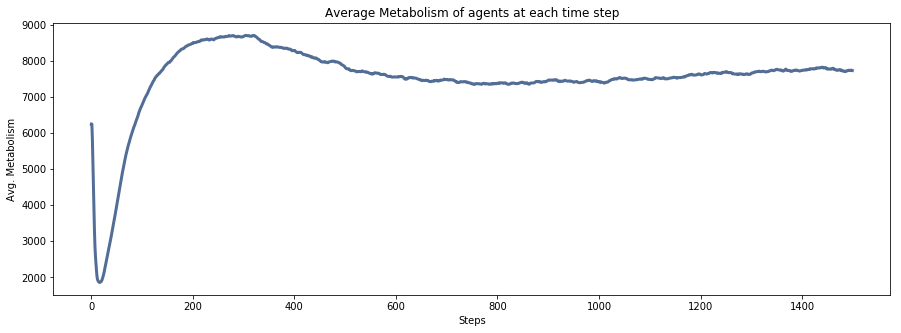

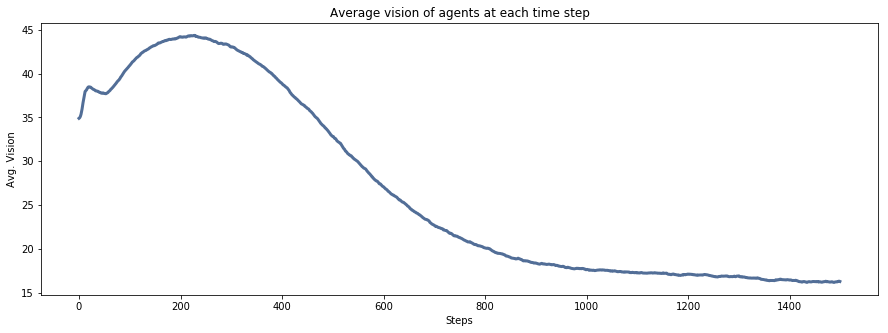

In [576]:
fig = plt.figure(figsize = (15,5))
for i in range(0,1):
    thinkplot.plot(avg_pop2[i])
thinkplot.Config(title = 'Average Metabolism of agents at each time step',
                 ylabel='Avg. Metabolism',
                 xlabel='Steps',
                 legend=True)

fig = plt.figure(figsize = (15,5))
for i in range(0,1):
    thinkplot.plot(avg_vis2[i])
thinkplot.Config(title = 'Average vision of agents at each time step',
                 ylabel='Avg. Vision',
                 xlabel='Steps',
                 legend=True)

In [570]:
avg_vis2[0][1499]

1.6574367502758942

___Figure 14:___ Average vision and population over 1500 steps.

Figure 14 shows the continuing trend and as expected the vision proceeds to a value between 1 and 2. This would prove what was being said previously. Overall it helps to indicate that not only is the environment a clear effect on the survivability of the agents, effect on metabolism, but the interrelationships between agents themselves effect the overall evaluation of the agents as the degree of competition and what is survivable changes over time. This would line up nicely with the noticeable rapid change in creature diversity after any mass extortion event in the past. Agents quickly evolve to meet the environment but then quickly settle out once the environments once again reach their capacity and certain behaviors become undesirable to survival.

## Culture, history and the War of  the Sugarscape

In [625]:
class Agent:
    
    def __init__(self, loc, params):
        """Creates a new agent at the given location.
        
        loc: tuple coordinates
        params: dictionary of parameters
        """
        self.loc = tuple(loc)
        self.age = 0
        #self.color = 'red'
        # extract the parameters
        max_vision = params.get('max_vision', 6)
        max_metabolism = params.get('max_metabolism', 4)
        min_lifespan = params.get('min_lifespan', 40)
        max_lifespan = params.get('max_lifespan', 80)
        min_child = params.get('min_child', 9)
        max_child = params.get('max_child', 16)
        min_elder = params.get('min_elder', 40)
        max_elder = params.get('max_elder', 60)
        min_sugar = params.get('min_sugar', 25)
        max_sugar = params.get('max_sugar', 50)
        
        # choose attributes
        self.vision = round(np.random.randint(1, max_vision+1))
        self.metabolism = round(np.random.uniform(1, max_metabolism))
        self.lifespan = round(np.random.uniform(min_lifespan, max_lifespan))
        self.child = np.random.uniform(min_child, max_child)
        self.elder = np.random.uniform(min_elder, max_elder)
        self.sugar = np.random.uniform(min_sugar, max_sugar)
        self.color = self.agent_color()
        self.sex   = np.random.randint(1,3) == 1

    def step(self, env):
        """Look around, move, and harvest.
        
        env: Sugarscape
        """
        self.loc = env.look_around(self.loc, self.vision)
        env.procreate(self)
        self.sugar += env.harvest(self.loc) - self.metabolism
        self.age += 1

    def is_starving(self):
        """Checks if sugar has gone negative."""
        return self.sugar < 0
    
    def is_old(self):
        """Checks if lifespan is exceeded."""
        return self.age > self.lifespan
    
    def can_procreate(self):
        """check if agent is of acceptable age to repoduce"""
        if self.age > self.child:
            if self.sex:
                return True
            else:
                return self.age < self.elder
            
    def agent_color(self):
        if self.metabolism == 2: 
            return 'blue'
        elif self.metabolism == 3:
            return 'purple'
        elif self.metabolism == 4:
            return 'red' 
        else: 
            return'green'

In [659]:
class Sugarscape(Cell2D):
    """Represents an Epstein-Axtell Sugarscape."""
    
    def __init__(self, n, **params):
        """Initializes the attributes.

        n: number of rows and columns
        params: dictionary of parameters
        """
        self.n = n
        self.params = params
        
        # track variables
        self.agent_count_seq = []
        self.grow_rate = params.get('growth_rate', 4)
        self.sugarpeaks = params.get('sugarpeaks', [[15,15],[35,35]])
        self.capacity,self.higher_capacity_locations  = self.make_capacity()
        #self.higher_capacity_locations
        
        self.blank_agent = Agent([0,0], params)
        self.occupied = np.full([n,n], self.blank_agent)
        
        # initially all cells are at capacity
        self.array = self.capacity.copy()
        
        # make the agents
        self.make_agents()
        #self.agents = self.make_agents()
        
        
    def make_capacity(self):
        """Makes the capacity array."""
        
        # compute the distance of each cell from the peaks. 
        x = np.arange(self.n)
        rows, cols = np.meshgrid(x, x, indexing='ij')
        
        # each cell in `rows` contains its own `i` coordinate
        # each cell in `cols` contains its `j` coordinate
        # creates the sugar peaks at this positions
        distHypots = []
        dist = np.hypot(rows-self.sugarpeaks[0][0], cols-self.sugarpeaks[0][1])
        for sugarpeakPos in self.sugarpeaks:
            distHypots.append(np.hypot(rows-sugarpeakPos[0], cols-sugarpeakPos[1]))
        
        for distHypot in distHypots:
            dist = np.minimum(dist, distHypot)
        
        # cells in the capacity array are set according to dist from peak
        a = np.zeros((self.n, self.n), np.float)
        a[dist>=16] = 1
        a[dist<16] = 2
        a[dist<11] = 3
        a[dist<6] = 4
        higher_capacity_counter = len(a[dist<6] == 4)
        
        return a, higher_capacity_counter 
        
    def make_agents(self):
        """Makes the agents."""
        
        # determine where the agents start and generate locations
        n, m = self.params.get('starting_box', self.array.shape)
        locs = make_locs(n, m)
        np.random.shuffle(locs)

        # make the agents
        num_agents = self.params.get('num_agents', 400)
        self.agents = [Agent(locs[i], self.params) 
                       for i in range(num_agents)]
        
        # keep track of which cells are occupied
        for agent in self.agents:
            self.occupied[agent.loc[0]][agent.loc[1]] = agent
            
        return self.agents
            
    def grow(self):
        """Adds sugar to all cells and caps them by capacity."""
        grow_rate = self.params.get('grow_rate', self.grow_rate)
        self.array = np.minimum(self.array + grow_rate, self.capacity)
        
    def look_around(self, center, vision):
        """Finds the visible cell with the most sugar.
        
        center: tuple, coordinates of the center cell
        vision: int, maximum visible distance
        
        returns: tuple, coordinates of best cell
        """
        # find all visible cells
        locs = make_visible_locs(vision)
        locs = (locs + center) % self.n
        
        # convert rows of the array to tuples
        locs = [tuple(loc) for loc in locs]
        empty_locs = []
        # select unoccupied cells
        for loc in locs:
            if self.occupied[loc[0]][loc[1]] == self.blank_agent:
                empty_locs.append(loc)
        
        # if all visible cells are occupied, stay put
        if len(empty_locs) == 0:
            return center
        
        # look up the sugar level in each cell
        t = [self.array[loc] for loc in empty_locs]
        
        # find the best one and return it
        # (in case of tie, argmax returns the first, which
        # is the closest)
        i = np.argmax(t)
        
        return empty_locs[i]
    
    def harvest(self, loc):
        """Removes and returns the sugar from `loc`.
        
        loc: tuple coordinates
        """
        sugar = self.array[loc]
        self.array[loc] = 0
        return sugar
    
    def step(self):
        """Executes one time step."""
        replace = self.params.get('replace', False)
        
        # loop through the agents in random order
        random_order = np.random.permutation(self.agents)
        for agent in random_order:
            
            # mark the current cell unoccupied
            self.occupied[agent.loc[0]][agent.loc[1]] = self.blank_agent
            
            # execute one step
            agent.step(self)

            # if the agent is dead, remove from the list
            if agent.is_starving() or agent.is_old():
                self.agents.remove(agent)
                if replace:
                    self.add_agent()
            else:
                # otherwise mark its cell occupied
                self.occupied[agent.loc[0]][agent.loc[1]] = agent
                if agent.can_procreate():
                    self.procreate(agent)

        # update the time series
        self.agent_count_seq.append(len(self.agents))
        
        # grow back some sugar
        self.grow()
        return len(self.agents)
    
    
    def procreate(self, agent):
        locs = make_visible_locs(1)
        locs = (locs + agent.loc) % self.n
        
        occupied_locs = []
        for loc in locs:
            if self.occupied[loc[0]][loc[1]] != self.blank_agent:
                occupied_locs.append(loc)
        
        for loc in occupied_locs:
            partner = self.occupied[loc[0]][loc[1]]
            
            new_loc = self.look_around(loc, 1)
            
            if not (new_loc[0] == loc[0] and new_loc[1] == loc[1]):
                
                if partner.can_procreate and partner.sex != agent.sex:
                    self.reproduce(agent, partner, new_loc)
    
    def reproduce(self, parent1, parent2, loc):
        if parent1:
            #parent1 is male
            sugar = parent1.sugar//2
            if sugar > parent2.metabolism//2:
                parent1.sugar -= sugar
                new_agent = Agent(loc, self.params)
                new_agent.sugar = sugar + (parent2.sugar//2)
                parent2.sugar -= new_agent.sugar - sugar
            else:
                return
        else:
            #parent2 is male
            sugar = parent2.sugar//2
            if sugar > parent1.metabolism//2:
                parent2.sugar -= sugar
                new_agent = Agent(loc, self.params)
                new_agent.sugar = sugar + (parent2.sugar//2)
                parent1.sugar -= new_agent.sugar - sugar
            else:
                return
        #genes of new agent
        if np.random.randint(1,3) == 1:
            new_agent.vision = parent1.vision
        else:
            new_agent.vision = parent2.vision
            
        if np.random.randint(1,3) == 1:
            new_agent.metabolism = parent1.vision
        else:
            new_agent.metabolism = parent2.vision
            
        if np.random.randint(1,3) == 1:
            new_agent.lifespan = parent1.vision
        else:
            new_agent.lifespan = parent2.vision
            
        if np.random.randint(1,3) == 1:
            new_agent.child = parent1.vision
        else:
            new_agent.child= parent2.vision
            
        if np.random.randint(1,3) == 1:
            new_agent.elder = parent1.vision
        else:
            new_agent.elder = parent2.vision
            
        agent.color = agent.agent_color()
        
        self.occupied[loc[0]][loc[1]] = new_agent
        self.agents.append(new_agent)
        return
            
    def add_agent(self):
        """Generates a new random agent.
                
        returns: new Agent
        """
        new_agent = Agent(self.random_loc(), self.params)
        self.agents.append(new_agent)
        self.occupied[new_agent.loc[0]][new_agent.loc[1]] = new_agent

        return new_agent
    
    def random_loc(self):
        """Choose a random unoccupied cell.
        
        returns: tuple coordinates
        """
        while True:
            loc = tuple(np.random.randint(self.n, size=2))
            if loc not in self.occupied:
                return loc
            
    def agents_metabolism_counter(self):
        low_met = 0
        mid_met = 0
        high_met = 0
        for agent in self.agents:
            if agent.color=='green' or agent.color=='purple':
                low_met = low_met+1
            elif agent.color=='blue':
                mid_met=mid_met+1
            elif agent.color=='red':
                high_met=high_met+1
        return low_met, mid_met, high_met

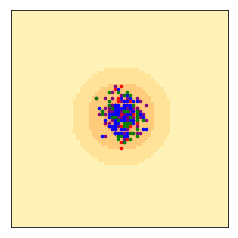

In [660]:
envA = Sugarscape(70, num_agents=300, sugarpeaks=sugarpeaksA)
viewerA  =  SugarscapeViewer(envA)
animA  =  viewerA.animate(frames=100)
animA

# References

1. Schelling, T. (1969). Models of Segregation. The American Economic Review, 59(2), 488–493.
2. Epstein, J. & Axtell, R. (1996). Growing Artificial Societies: Social Science from the Bottom Up. Place of publication not identified: MIT Press.

In [183]:
import io
import sys

s = io.StringIO('2\n\
4\n\
')

sys.stdin  = s


In [184]:
val1 = input()
print(val1)

asildas
asildas
